In [1]:
from Burstsearch_forallROIs import *

In [2]:
from matplotlib.pylab import *
from numpy import *
%matplotlib inline

In [3]:
#wave = loadtxt("allROIsSignal_OnState_wave.dat")
#ctrl = loadtxt("allROIsSignal_OnState_contrl.dat")

#print("Wave shape",wave.shape)
#print("Ctrl shape",ctrl.shape)

#nrois2, nframes = wave.shape
#nrois = nrois2//2

#thf = 0.6

#fullstats = {}

In [4]:
with open("./fullstats.dat","rb") as f:
    fullstats = pickle.load(f)

In [5]:
nrois = len(fullstats)
fullstats[0][0].keys()


dict_keys(['burstIdF', 'burstIdF stats', 'burstIdF score', 'Selected dF/F', 'Unselected dF/F', 'SelecteddF dR', 'Unselected dR', 'burstIdR', 'burstIdR stats', 'burstIdR score', 'Selected dR', 'F number', 'F Av length', 'F Total length', 'F Burst score', 'F Burst score per cycle', 'F Burst score per frame', 'F skipped time', 'R number', 'R Av length ', 'R Total length', 'R Burst score', 'R Burst score per time', 'R Burst score per frame', 'R skipped time', 'overlap'])

In [6]:
type(fullstats[0][0])

dict

Text(0.5,0,'log10(dF)')

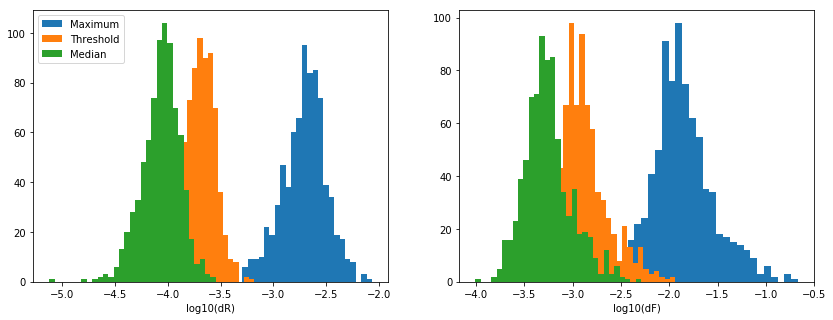

In [7]:
fig = figure(figsize=(14,5))
subplot(121)
burstRStats = zeros((nrois,3))
sel = []
for i in range(nrois):
    #print(i,fullstats[i][0]['burstIdR stats'])
    if type(fullstats[i][0]) is dict:
        #print(i,fullstats[i][0])
        burstRStats[i,:] = fullstats[i][0]['burstIdR stats']
        sel.append(i)
        
selR = array(sel)
burstRStats = burstRStats[selR,:]
hist(log10(burstRStats[:,0]),31,label="Maximum")
hist(log10(burstRStats[:,1]),31,label="Threshold")
hist(log10(burstRStats[:,2]),31,label="Median")
xlabel("log10(dR)")
legend()
subplot(122)
burstFStats = zeros((nrois,3))
sel = []
for i in range(nrois):
    #print(i,fullstats[i][0]['burstIdR stats'])
    if type(fullstats[i][0]) is dict:
        #print(i,fullstats[i][0])
        burstFStats[i,:] = fullstats[i][0]['burstIdF stats']
        sel.append(i)
        
selR = array(sel)
burstFStats = burstFStats[selR,:]
hist(log10(burstFStats[:,0]),31)
hist(log10(burstFStats[:,1]),31)
hist(log10(burstFStats[:,2]),31)
xlabel("log10(dF)")


In [8]:
fullstats[i][0]['burstIdR score']

array([[ 4.08738904e-01,  2.39575560e-02,  1.50000000e+01,
         5.40000000e+01],
       [ 3.88718333e-01,  2.05563676e-02,  1.20000000e+01,
         2.40000000e+01],
       [ 4.04235800e-01,  2.22149245e-02,  1.30000000e+01,
         3.00000000e+01],
       [ 3.97394037e-01,  2.86860589e-02,  1.30000000e+01,
         4.40000000e+01],
       [-4.80148821e-01,  5.66642258e-02,  1.60000000e+01,
         3.80000000e+01],
       [-4.87251510e-01,  4.07993525e-02,  2.00000000e+01,
         7.80000000e+01],
       [ 4.60567243e-01,  2.72580645e-02,  1.40000000e+01,
         2.80000000e+01],
       [-4.20765456e-01,  3.03440633e-02,  1.20000000e+01,
         2.80000000e+01],
       [-7.95807053e-01,  5.39070662e-02,  2.50000000e+01,
         5.60000000e+01],
       [-4.43347076e-01,  2.00256846e-02,  1.30000000e+01,
         2.60000000e+01],
       [ 4.02274697e-01,  2.33228769e-02,  1.30000000e+01,
         2.60000000e+01],
       [ 3.84116712e-01,  3.15316511e-02,  1.20000000e+01,
      

Text(0.5,0,'F Burst score / frame')

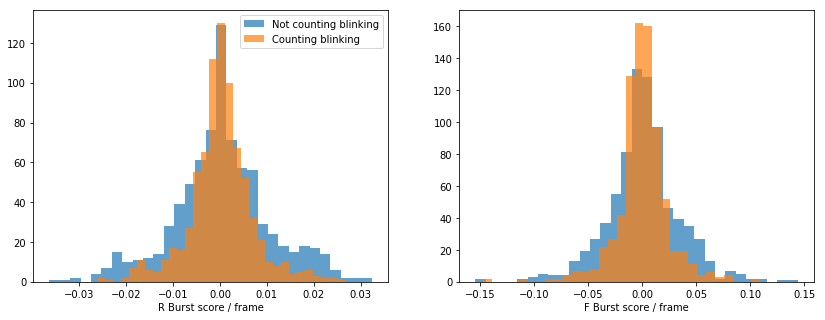

In [9]:
fig = figure(figsize=(14,5))
subplot(121)
bR = zeros((nrois,2))
bF = zeros((nrois,2))
sel = []
for i in range(nrois):
    #print(i,fullstats[i][0]['burstIdR stats'])
    if type(fullstats[i][0]) is dict:
        temp = fullstats[i][0]['burstIdR score']
        bR[i,:] = (mean(temp[:,0]/temp[:,-1]),mean(temp[:,0]/temp[:,-2]/2.0))
        sel.append(i)
        
selR = array(sel)
bR = bR[selR,:]
hist(bR[:,1],31,label="Not counting blinking",alpha=0.7)
hist(bR[:,0],31,label="Counting blinking",alpha=0.7)
xlabel("R Burst score / frame")
legend()
subplot(122)
sel = []
for i in range(nrois):
    #print(i,fullstats[i][0]['burstIdR stats'])
    if type(fullstats[i][0]) is dict:
        temp = fullstats[i][0]['burstIdF score']
        bF[i,:] = (mean(temp[:,0]/temp[:,-1]),mean(temp[:,0]/temp[:,-2]/2.0))
        sel.append(i)
        
selF = array(sel)
bF = bF[selF,:]
hist(bF[:,1],31,alpha=0.7)
hist(bF[:,0],31,alpha=0.7)
xlabel("F Burst score / frame")

Text(0.5,0,'F Burst score / frame')

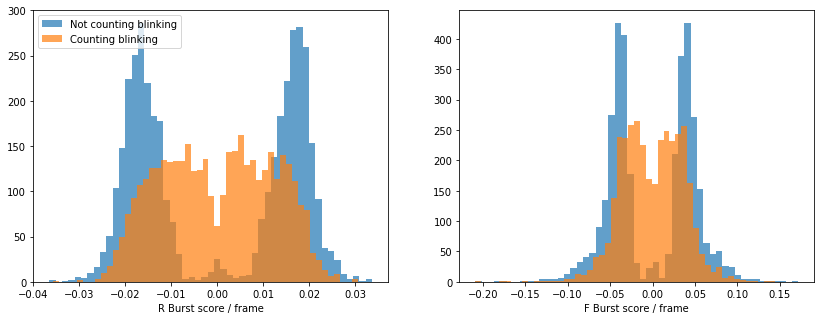

In [76]:
fig = figure(figsize=(14,5))
subplot(121)
#bR = zeros((nrois,2))
#bF = zeros((nrois,2))
bR = []
bF = []
sel = []
for i in range(nrois):
    #print(i,fullstats[i][0]['burstIdR stats'])
    if type(fullstats[i][0]) is dict:
        temp = fullstats[i][0]['burstIdR score']
        for k in range(temp.shape[0]):
            bR.append([temp[k,0]/temp[k,-1],temp[k,0]/temp[k,-2]/2.0])
        sel.append(i)
        
bR = array(bR)
#selR = array(sel)
#bR = bR[selR,:]
hist(bR[:,1],51,label="Not counting blinking",alpha=0.7)
hist(bR[:,0],51,label="Counting blinking",alpha=0.7)
xlabel("R Burst score / frame")
legend()
subplot(122)
sel = []
for i in range(nrois):
    #print(i,fullstats[i][0]['burstIdR stats'])
    if type(fullstats[i][0]) is dict:
        temp = fullstats[i][0]['burstIdF score']
        for k in range(temp.shape[0]):
            bF.append([temp[k,0]/temp[k,-1],temp[k,0]/temp[k,-2]/2.0])
        sel.append(i)
        
bF = array(bF)
#selF = array(sel)
#bF = bF[selF,:]
hist(bF[:,1],51,alpha=0.7)
hist(bF[:,0],51,alpha=0.7)
xlabel("F Burst score / frame")

In [77]:
print(mean(bR[bR[:,1]<0,1])-3*std(bR[bR[:,1]<0,1]),mean(bR[bR[:,1]>0,1])+3*std(bR[bR[:,1]>0,1]))
print(mean(bF[bF[:,1]<0,1])-3*std(bF[bF[:,1]<0,1]),mean(bF[bF[:,1]>0,1])+3*std(bF[bF[:,1]>0,1]))

-0.02972559505859628 0.030020574953460506
-0.10435296789029058 0.10036562672110594


(array([29., 13., 18., 31., 30., 34., 31., 56., 44., 55., 37., 39., 33.,
        33., 35., 32., 38., 36., 27., 25., 21., 21., 10.,  9., 10., 11.,
        15.,  5.,  5.,  4.,  3.]),
 array([0.        , 0.03096164, 0.06192328, 0.09288492, 0.12384656,
        0.15480821, 0.18576985, 0.21673149, 0.24769313, 0.27865477,
        0.30961641, 0.34057805, 0.37153969, 0.40250133, 0.43346298,
        0.46442462, 0.49538626, 0.5263479 , 0.55730954, 0.58827118,
        0.61923282, 0.65019446, 0.6811561 , 0.71211775, 0.74307939,
        0.77404103, 0.80500267, 0.83596431, 0.86692595, 0.89788759,
        0.92884923, 0.95981087]),
 <a list of 31 Patch objects>)

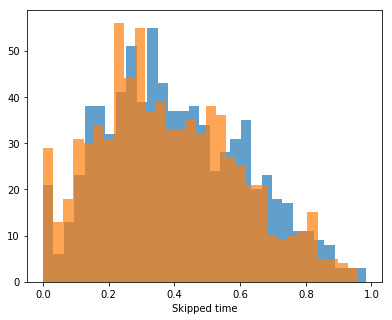

In [23]:
fig = figure(figsize=(14,5))
subplot(121)
bR = zeros((nrois,1))
bF = zeros((nrois,1))
sel = []
for i in range(nrois):
    #print(i,fullstats[i][0]['burstIdR stats'])
    if type(fullstats[i][0]) is dict:
        temp = fullstats[i][0]['R skipped time']
        bR[i,:] = temp
        sel.append(i)
        
selR = array(sel)
bR = bR[selR,:]
hist(bR[:,0],31,label="R",alpha=0.7)
xlabel("Skipped time")
#legend()
#subplot(122)
sel = []
for i in range(nrois):
    #print(i,fullstats[i][0]['burstIdR stats'])
    if type(fullstats[i][0]) is dict:
        temp = fullstats[i][0]['F skipped time']
        bF[i,:] = temp
        sel.append(i)
        
selF = array(sel)
bF = bF[selF,:]
hist(bF[:,0],31,alpha=0.7)
#xlabel("F Burst score / frame")

In [24]:
wave = loadtxt("allROIsSignal_OnState_wave.dat")
#ctrl = loadtxt("allROIsSignal_OnState_contrl.dat")

In [25]:
print("Wave shape",wave.shape)
#print("Ctrl shape",ctrl.shape)

nrois2, nframes = wave.shape
nrois = nrois2//2
framespercycle = 4
framespercycle2 = framespercycle//2

i = randint(nrois)
FB = 1.0*wave[i,:] # Blue channel
FA = 1.0*wave[i+nrois,:] # red channel
St = FA+FB

St,SX,Stt,SXt,dR,dF,idxF,Fav = preparedata(FA,FB,4,nframes)

Wave shape (2062, 6000)


In [13]:
stats = fullstats[i][0]

In [26]:
def thousands(x, pos):
    'The two args are the value and tick position'
    return '%1.0fk' % (x*1e-3)

def shadeBurstIntervals(burst,t,idxF,ymin = None, ymax = None, color='gray',alpha = 0.7):
    '''burst = stats["burstIdR"]
    '''
    #print("Burst R:",burst)
    currentAxis = gca()
    if ymin is None or ymax is None:
        axes = gca()
        ymint, ymaxt = axes.get_ylim()
        if ymin is None:
            ymin = ymint
        if ymax is None:
            ymax = ymint
            
    for b in burst:
        #print(b)
        t0,tf = idxF[b[0]:b[1]][array([0,-1])]
        tf += 2
        #print(t0,tf)
        tsb = t[t0:tf].flatten()
        #print(tsb[0],tsb[-1])
        nsel = arange(tsb.shape[0]-1)[(tsb[1:]-tsb[:-1]-0.01>0.0005)]
        s0 = 0
        #print('nsel shape:',nsel.shape)#,tsb,b,ts.shape)
        if nsel.shape[0]>0:
            s0 = 0
            for s1 in nsel:
                currentAxis.add_patch(Rectangle((tsb[s0], ymin), tsb[s1]-tsb[s0], ymax,alpha=alpha,color=color))
                s0 = s1+1
        else:
            #print('Limits ',tsb[0],tsb[-1],ymin,ymax)
            currentAxis.add_patch(Rectangle((tsb[0], ymin), tsb[-1]-tsb[0], ymax,alpha=alpha,color=color))

    return

def subPlots(tst,Stt2,t,idxF,b, bscoret = None,formatterL = True):
    currentAxis = gca()
    if formatterL:
        formatter = FuncFormatter(thousands)
        currentAxis.yaxis.set_major_formatter(formatter)
    
    plot(tst.flatten(),Stt2,'C0-',alpha=0.7)
    plot(tst.flatten(),Stt2,'C0.',alpha=0.7)
    
    sqwup = (arange(Stt2.shape[0])%2)==0
    plot(tst[sqwup],Stt2[sqwup],'C3.',alpha=0.7)
    
    
    #tsb = ts[b[0]:b[1],:].flatten()
    t0,tf = idxF[b[0]:b[1]][array([0,-1])]
    tf += 2
    tsb = t[t0:tf].flatten()    
    xlim(tsb[0],tsb[-1])
    bottom, top = ylim()
    
    #print(bscoret,tsb,ab)
    if bscoret is not None:
        text(tsb[0]+(tsb[-1]-tsb[0])*.02,top-(top-bottom)*.02,'Burst score/ frames: %.2e' % bscoret, ha='left', va='top')
    xlabel('t (s)')
    
    plot(tst.flatten(),bottom+(top-bottom)*0.005+(1+sign(sin(2*pi*tst.flatten()*25.0)))*(top-bottom)*0.17/2.0,'k-')
    return

def arangesubPlots(subPlots,burst,Stt2,tst,t,idxF,ab,bscoret,grid,formatterL = True):
    if len(ab)>=3:
        for ib in range(3):
            b = burst[ab][ib]
            subplot(grid[2, 2*ib:(2*ib+2)])
           
            subPlots(tst,Stt2,t,idxF,b,bscoret[ib],formatterL)
    if len(ab)==2:
        for ib in range(2):
            b = burst[ab][ib]
            subplot(grid[2, 3*ib:(3*ib+3)])
           
            subPlots(tst,Stt2,t,idxF,b,bscoret[ib],formatterL)
    if len(ab)==1:
        for ib in range(1):
            b = burst[ab][ib]
            #print(db)
            subplot(grid[2,:])
            subPlots(tst,Stt2,t,idxF,b,bscoret[ib],formatterL)
    return
    

In [27]:
def plotFigureF(Stt,idxF,stats,ctitle = ""):
    dt = 10e-3
    formatter = FuncFormatter(thousands)


    # Time with nan intervals removed
    t = arange(0,Stt.shape[0]*Stt.shape[1])*dt
    ts4 = t.reshape(t.shape[0]//framespercycle,framespercycle)
    ts2 = t.reshape(t.shape[0]//framespercycle2,framespercycle2)[idxF//2,:]
    
    ts4 = column_stack((ts4[:,:framespercycle2].mean(axis=1),ts4[:,framespercycle2:].mean(axis=1))).flatten()
    Stt2 = column_stack((Stt[:,:framespercycle2].mean(axis=1),Stt[:,framespercycle2:].mean(axis=1))).flatten()


    t[isnan(FA)] = nan    

    fig = figure(figsize=(14,10))
    grid = plt.GridSpec(3, 6, wspace=0.4, hspace=0.2)

    plt.subplot(grid[:2, 0:])
    title(ctitle)
    currentAxis = gca()
    
    plot(ts4,Stt2,'C0-',alpha=0.7)
    plot(ts4,Stt2,'C0.',alpha=0.7)
    
    ymin = min(Stt2[isfinite(Stt2)])*.98
    ymax = max(Stt2[isfinite(Stt2)])*1.02
    
    currentAxis.yaxis.set_major_formatter(formatter)

    shadeBurstIntervals(stats["burstIdF"],t,idxF,ymin , ymax, color='gray',alpha = 0.7)
    shadeBurstIntervals(stats["burstIdR"],t,idxF,ymin , ymax, color='deeppink',alpha = 0.7)

    xlabel("t(s)")
    ylabel("F (cps)")

    # Subplots - Zooming in
    burst = stats["burstIdF"]
    bscore = stats["burstIdF score"]
    bscoret = bscore[:,0]/bscore[:,-1]

    burst = burst
    bscoret = bscoret
    ab = (-abs(bscoret)).argsort()
    bscoret = bscoret[ab]
    
    arangesubPlots(subPlots,burst,Stt2,ts4,t,idxF,ab,bscoret,grid,formatterL = True)
    
    return

#plotFigureF(Stt,idxF,stats,ctitle ="ROI number "+str(i+1).zfill(4))

/users/bssn/serna/environments/deepl/lib/python3.6/site-packages/ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in greater


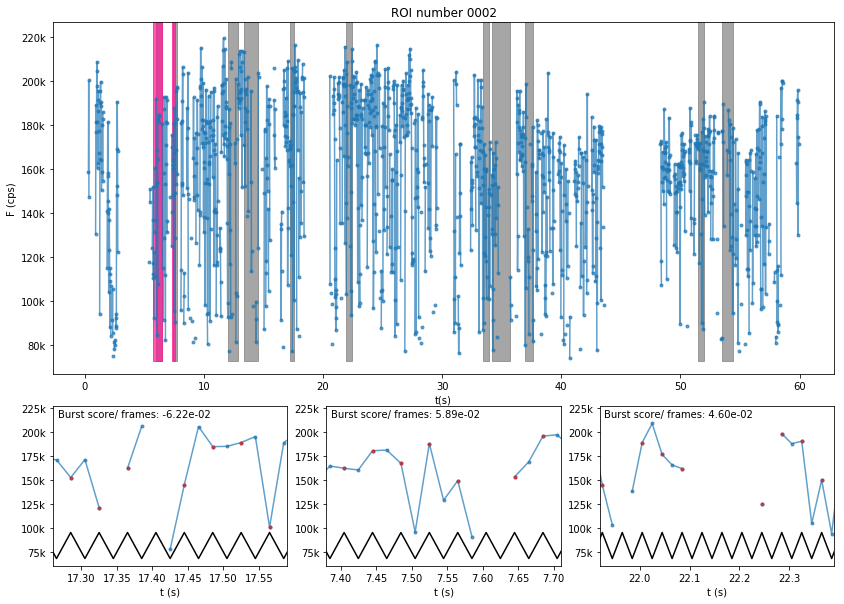

In [28]:
i = 1 #randint(nrois)
FB = 1.0*wave[i,:] # Blue channel
FA = 1.0*wave[i+nrois,:] # red channel
St = FA+FB

St,SX,Stt,SXt,dR,dF,idxF,Fav = preparedata(FA,FB,4,nframes)
stats = fullstats[i][0]
if type(stats) is dict:
    plotFigureF(Stt,idxF,stats,ctitle ="ROI number "+str(i+1).zfill(4))
    burst = stats["burstIdF"]
    bscore = stats["burstIdF score"]
    bscoret = bscore[:,0]/bscore[:,-1]
else:
    print('no data in ',i)

In [23]:
stats = fullstats[i][0]
temp = stats['burstIdF score']
temp

array([[ -1.9338031 ,   1.13875326,  12.        ,  56.        ],
       [  2.0041893 ,   0.9977419 ,  14.        ,  34.        ],
       [ -2.09208944,   1.28090291,  13.        ,  90.        ],
       [  2.72424346,   0.99490591,  15.        , 118.        ],
       [ -2.11588196,   1.34301316,  13.        ,  34.        ],
       [  2.20906933,   1.14208873,  12.        ,  48.        ],
       [  1.97709227,   0.87689454,  15.        ,  48.        ],
       [  2.35050264,   0.75893374,  15.        , 154.        ],
       [ -2.2721856 ,   0.79278467,  12.        ,  62.        ],
       [  2.39709632,   0.98118798,  15.        ,  56.        ],
       [  1.97180504,   0.74173195,  12.        ,  88.        ]])

/users/bssn/serna/environments/deepl/lib/python3.6/site-packages/ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in greater
/users/bssn/serna/environments/deepl/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


225


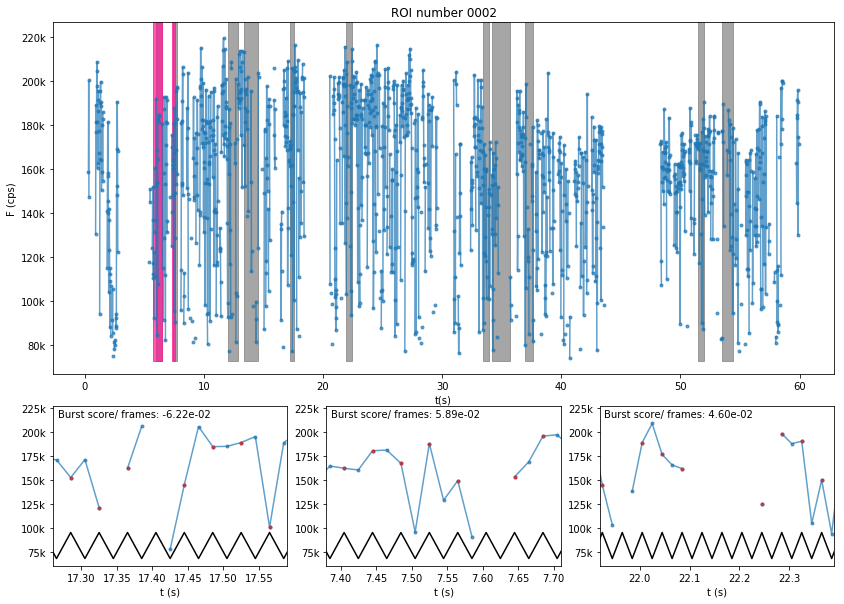

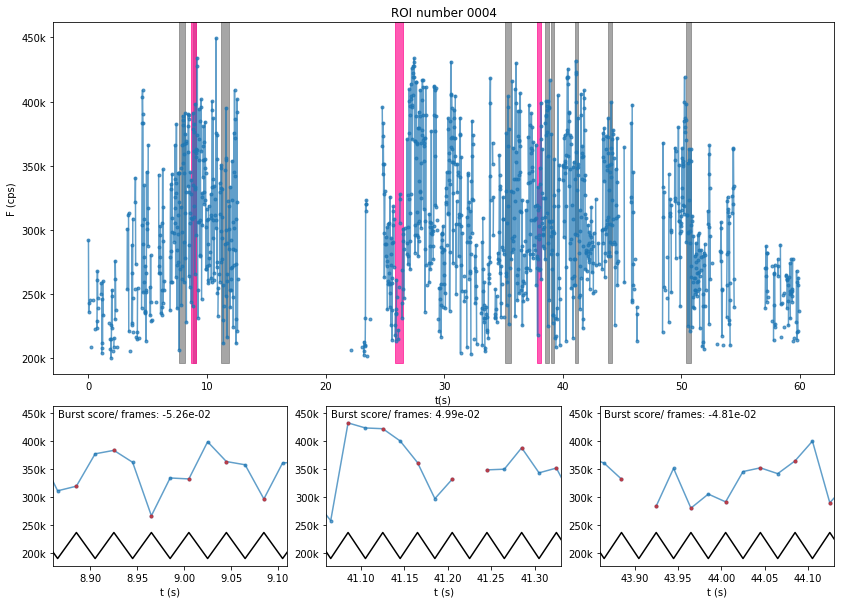

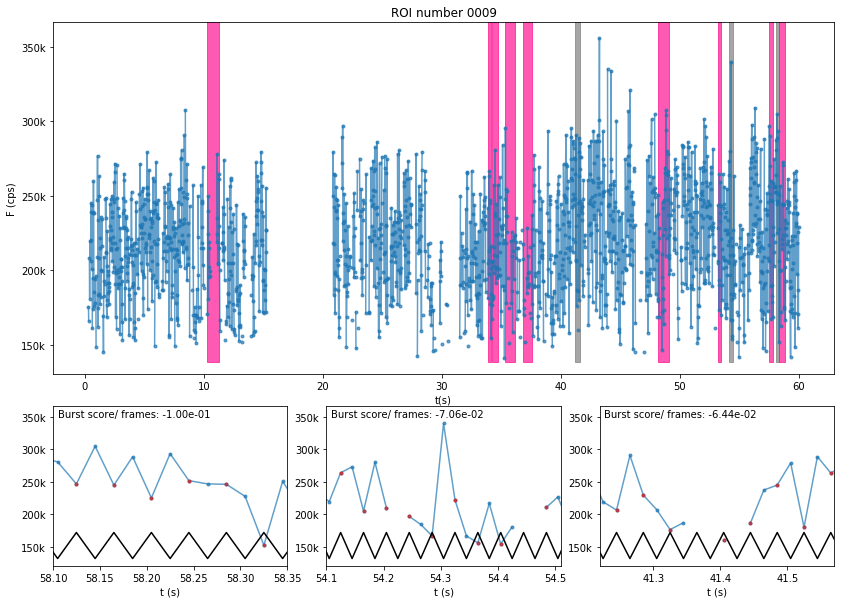

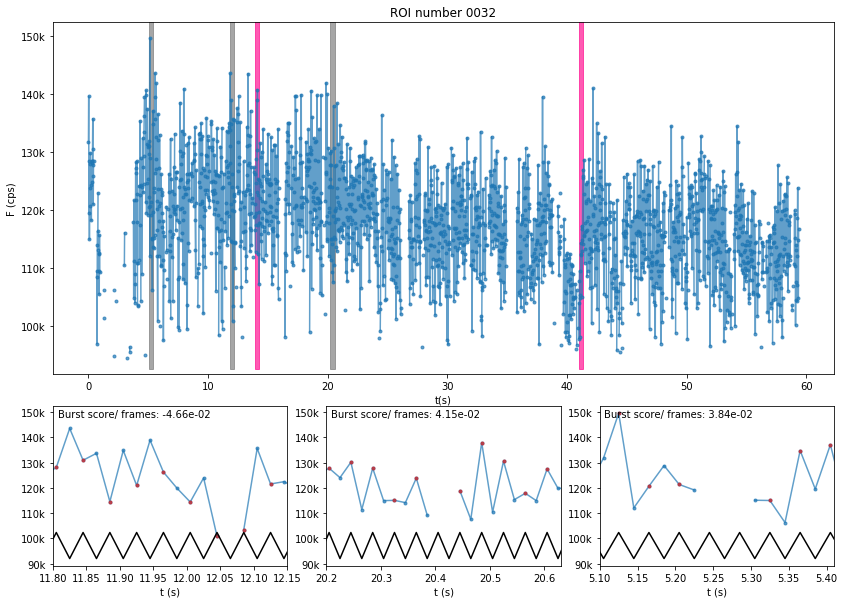

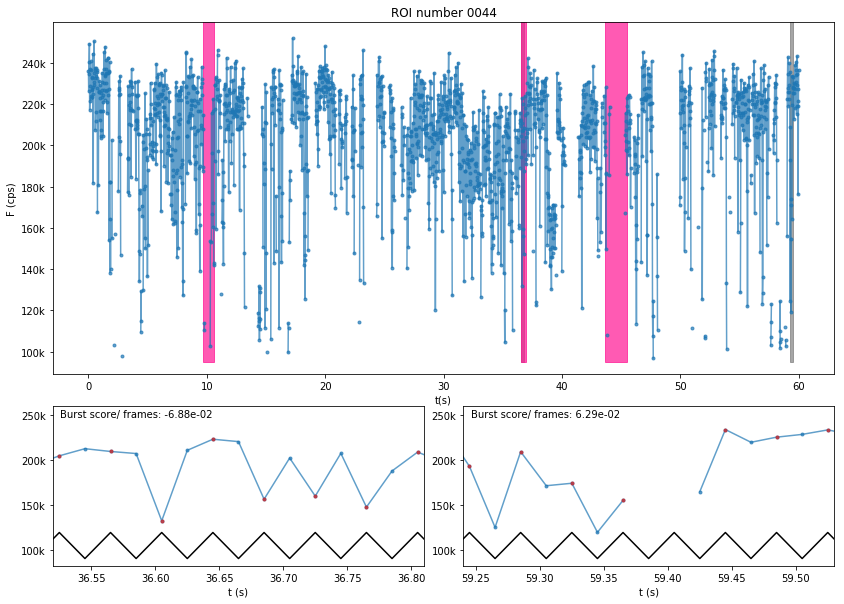

...

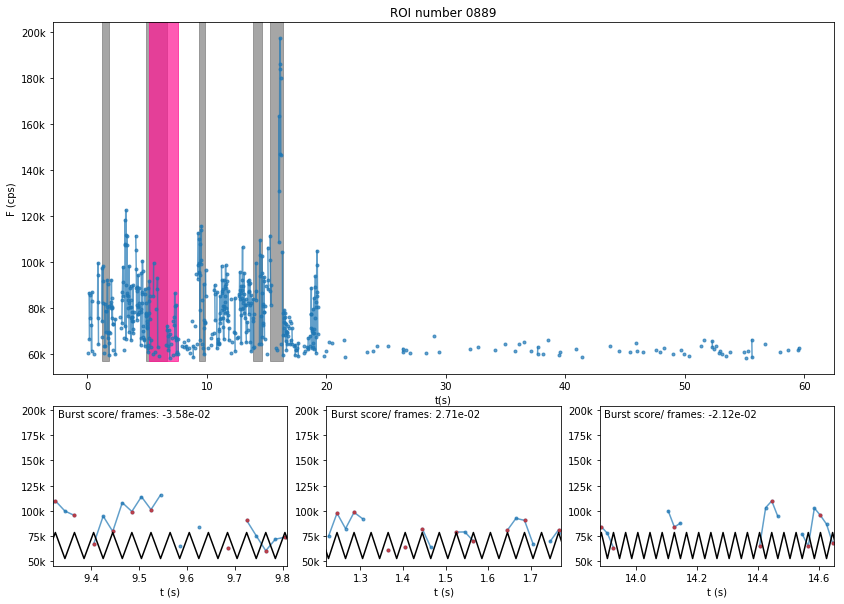

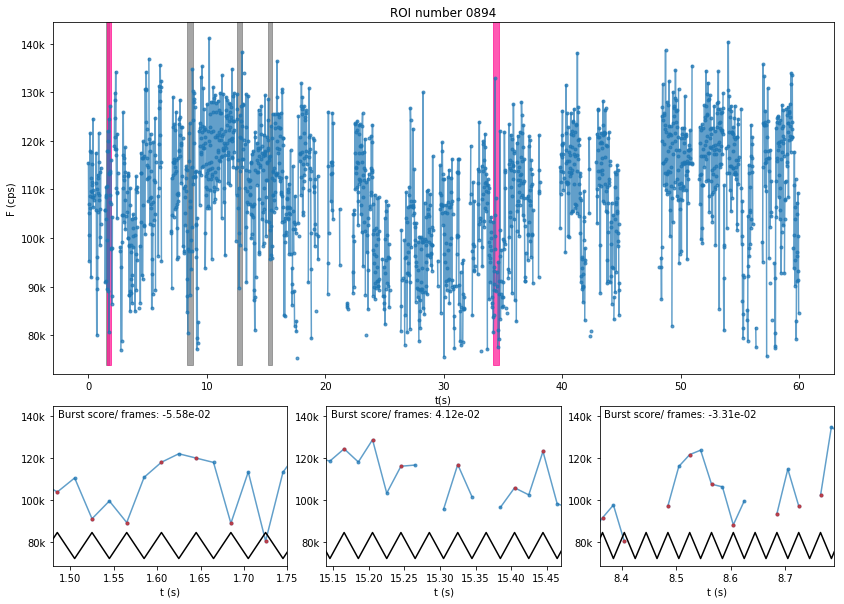

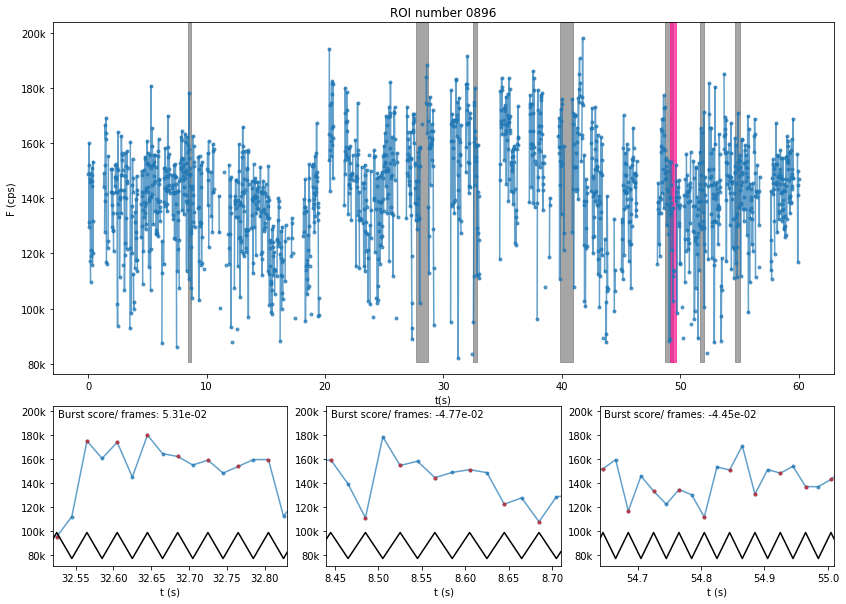

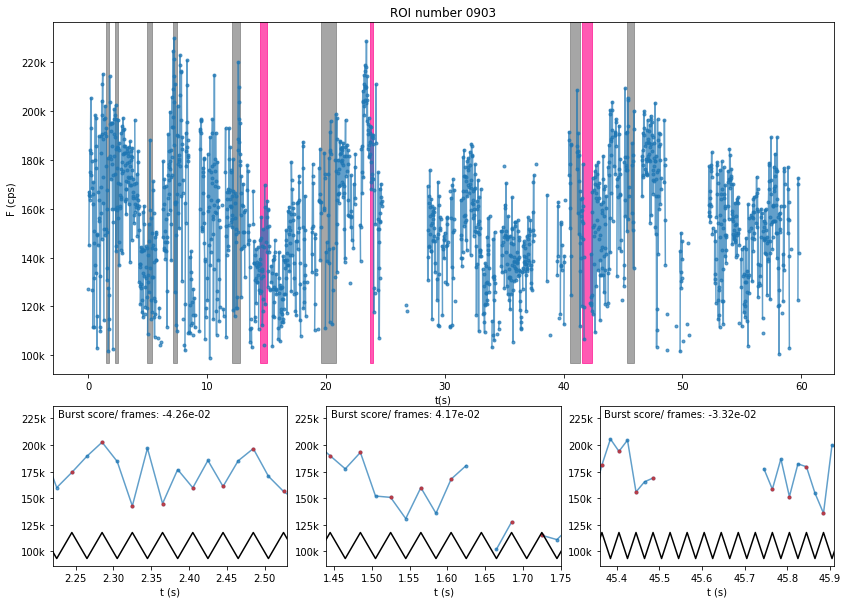

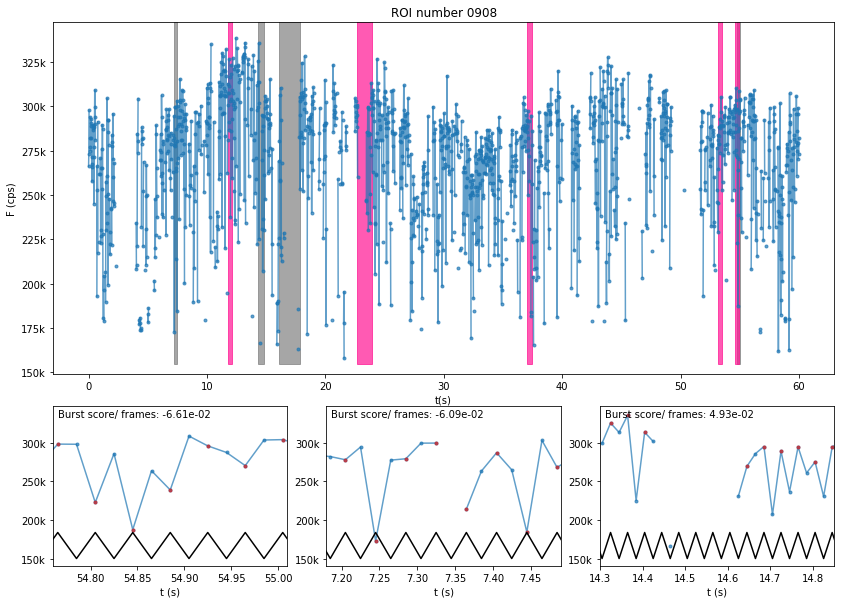

In [ ]:
total = 0
for i in range(nrois):
    stats = fullstats[i][0]
    if type(stats) is dict:
        temp = stats['burstIdF score']
        try:
            if sum(abs(temp[:,0]/temp[:,-2])>0.1)>1:
                FB = 1.0*wave[i,:] # Blue channel
                FA = 1.0*wave[i+nrois,:] # red channel
                St = FA+FB

                St,SX,Stt,SXt,dR,dF,idxF,Fav = preparedata(FA,FB,4,nframes)
                stats = fullstats[i][0]
                #print((temp[:,0]/temp[:,-1]))
                plotFigureF(Stt,idxF,stats,ctitle ="ROI number "+str(i+1).zfill(4))
                total +=1
        except Exception as e:
            print(i," roi:",e)
print(total)

In [20]:
def plotFigureR(SXt,idxF,stats,ctitle = ""):
    dt = 10e-3
    # preparing data
    # The time
    t = arange(0,SXt.shape[0]*SXt.shape[1])*dt
       
    # The time in 4 columns
    tst = t.reshape(t.shape[0]//framespercycle,framespercycle)
    # The time without wrong intervals
    
    #ts = tst[sel,:].reshape(sum(sel)*2,framespercycle2)
    ts = t.reshape(t.shape[0]//framespercycle2,framespercycle2)[idxF//2,:]
    
    tst = column_stack((tst[:,:framespercycle2].mean(axis=1),tst[:,framespercycle2:].mean(axis=1))).flatten()
    Stt2 = column_stack((SXt[:,:framespercycle2].mean(axis=1),SXt[:,framespercycle2:].mean(axis=1))).flatten()

    t[isnan(SXt.flatten())] = nan

    #ts = tst.reshape(t.shape[0]//framespercycle,framespercycle2)*1.0
    #print(ts.shape)

    fig = figure(figsize=(14,10))
    grid = plt.GridSpec(3, 6, wspace=0.4, hspace=0.2)

    plt.subplot(grid[:2, 0:])
    title(ctitle)
    currentAxis = gca()
    
    plot(tst.flatten(),Stt2,'C0-',alpha=0.7)
    plot(tst.flatten(),Stt2,'C0.',alpha=0.7)
    
    #print(burst)
    ymin = min(Stt2[isfinite(Stt2)])*.98
    ymax = max(Stt2[isfinite(Stt2)])*1.02

    shadeBurstIntervals(stats["burstIdF"],t,idxF,ymin , ymax, color='gray',alpha = 0.7)
    shadeBurstIntervals(stats["burstIdR"],t,idxF,ymin , ymax, color='deeppink',alpha = 0.7)

    xlabel("t(s)")
    ylabel("F (cps)")

    # Subplots - Zooming in
    burst = stats["burstIdR"]
    bscore = stats["burstIdR score"]
    bscoret = bscore[:,0]/bscore[:,-1]

    burst = burst
    bscoret = bscoret
    ab = (-abs(bscoret)).argsort()
    bscoret = bscoret[ab]
    arangesubPlots(subPlots,burst,Stt2,tst,t,idxF,ab,bscoret,grid,formatterL = False)


In [21]:
i = 1022
stats = fullstats[i][0]
#print(stats)
if type(stats) is dict:
    temp = stats['burstIdR score']
    #print(temp)
    if sum(abs(temp[:,0]/temp[:,-1])>0.024)>1:
        total +=1

        FB = 1.0*wave[i,:] # Blue channel
        FA = 1.0*wave[i+nrois,:] # red channel
        St = FA+FB

        St,SX,Stt,SXt,dR,dF,idxF,Fav = preparedata(FA,FB,4,nframes)
        #print(SX[:4],idxF[:4])
        stats = fullstats[i][0]
        #print((temp[:,0]/temp[:,-1]))
#print(stats['burstIdR'],dR.shape)
#print(SXt.shape)

plotFigureR(SXt,idxF,stats,ctitle ="ROI number "+str(i+1).zfill(4))

NameError: name 'total' is not defined

/users/bssn/serna/environments/deepl/lib/python3.6/site-packages/ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in greater


17


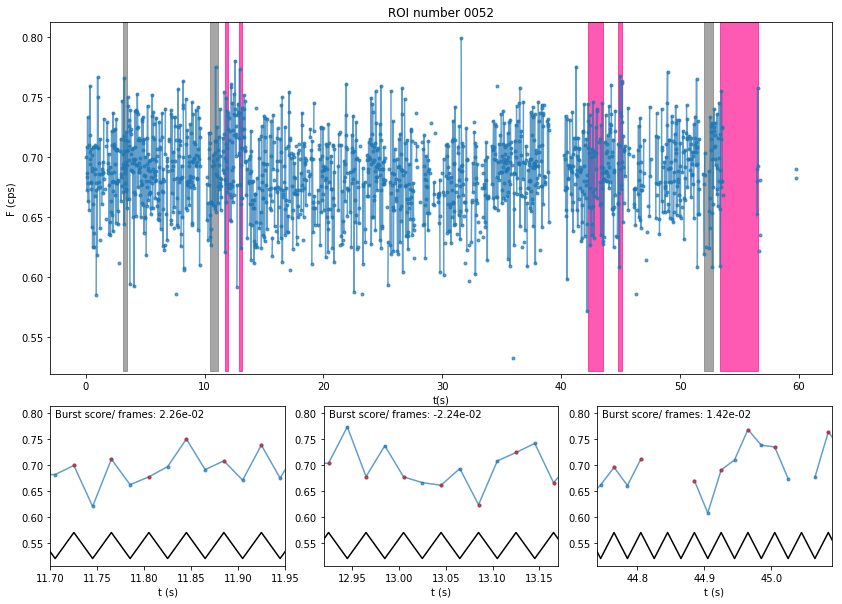

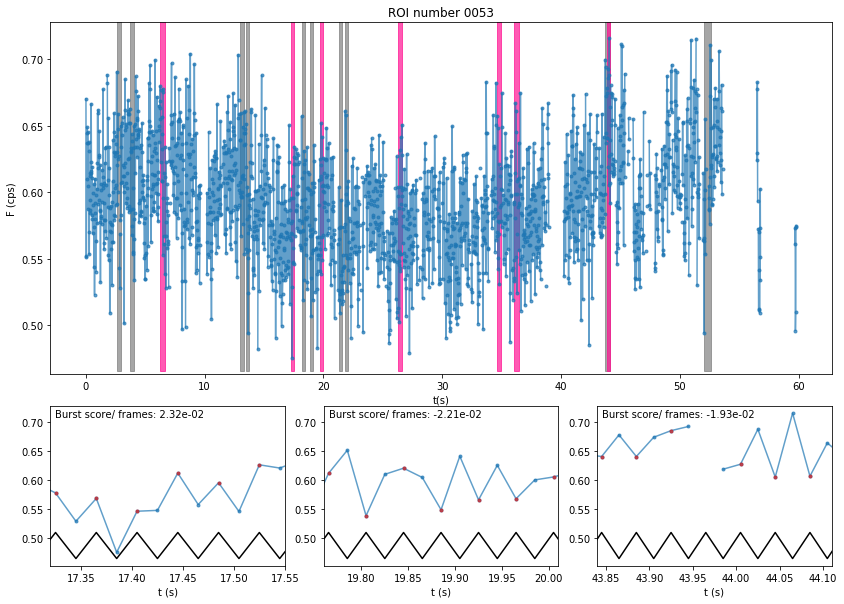

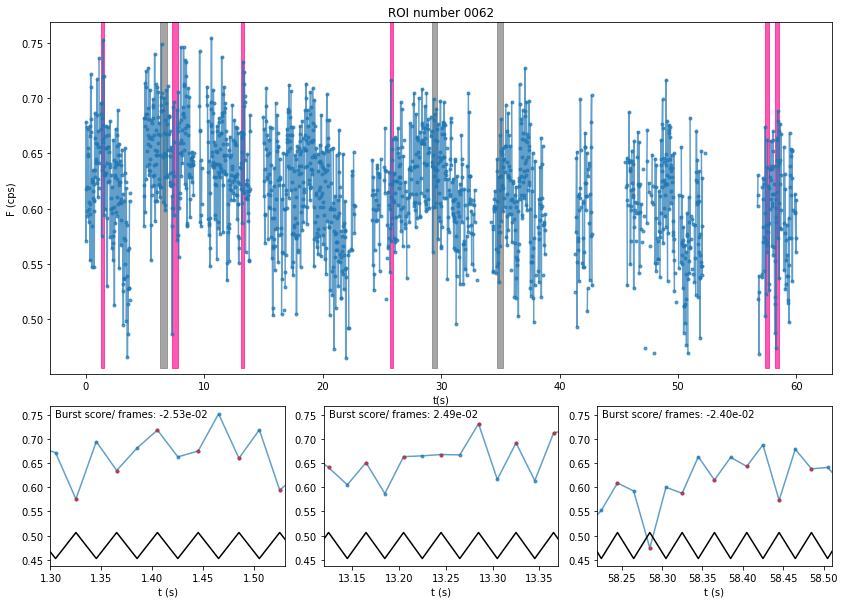

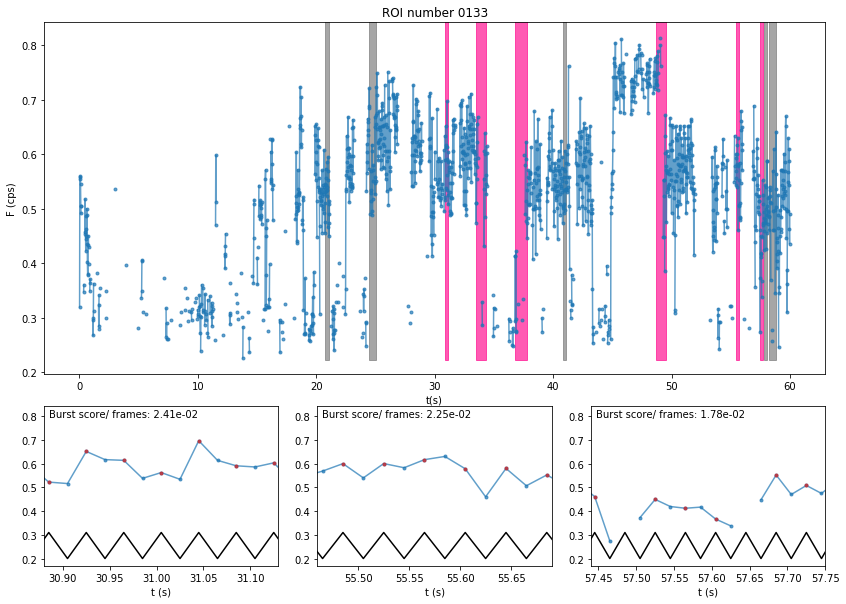

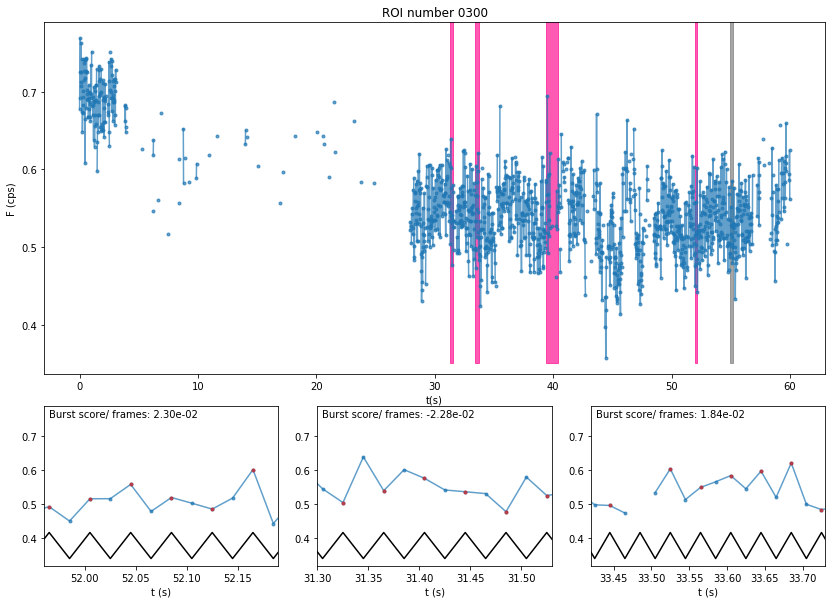

...

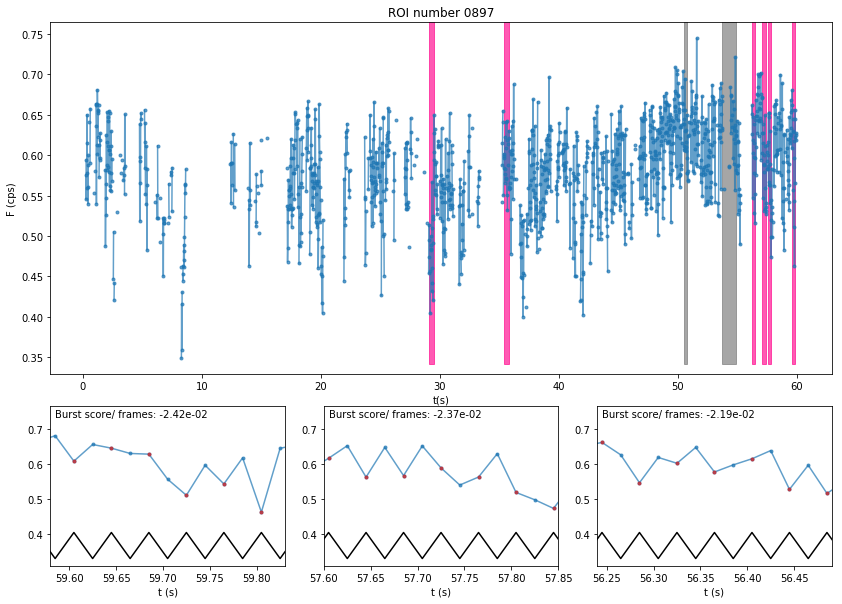

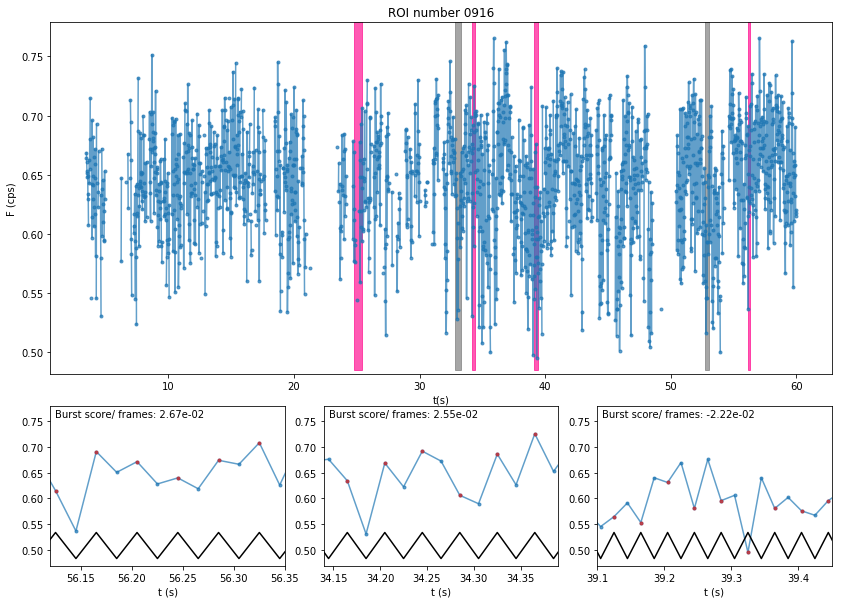

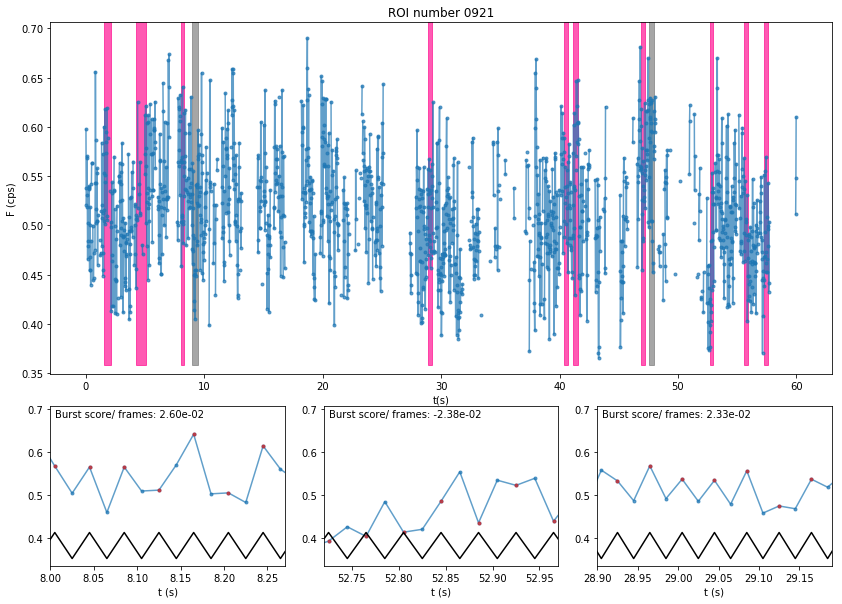

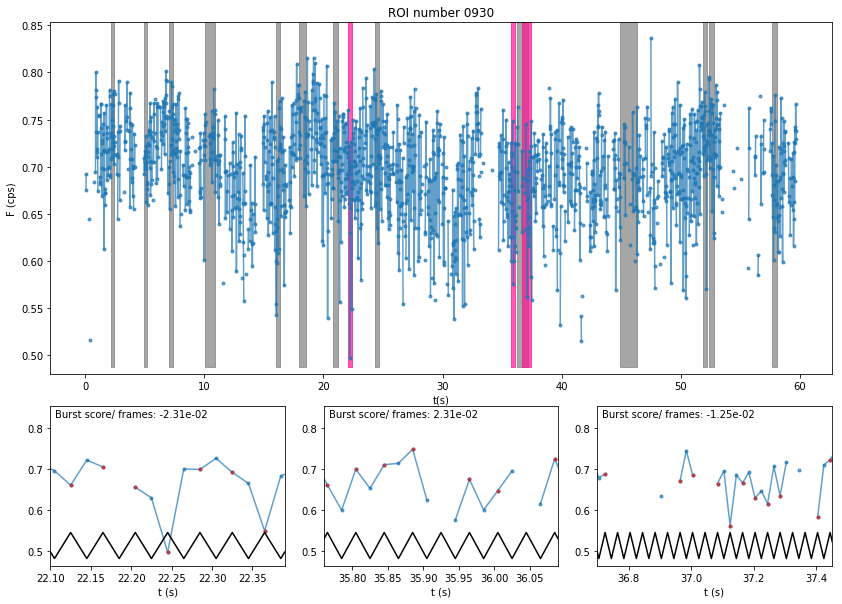

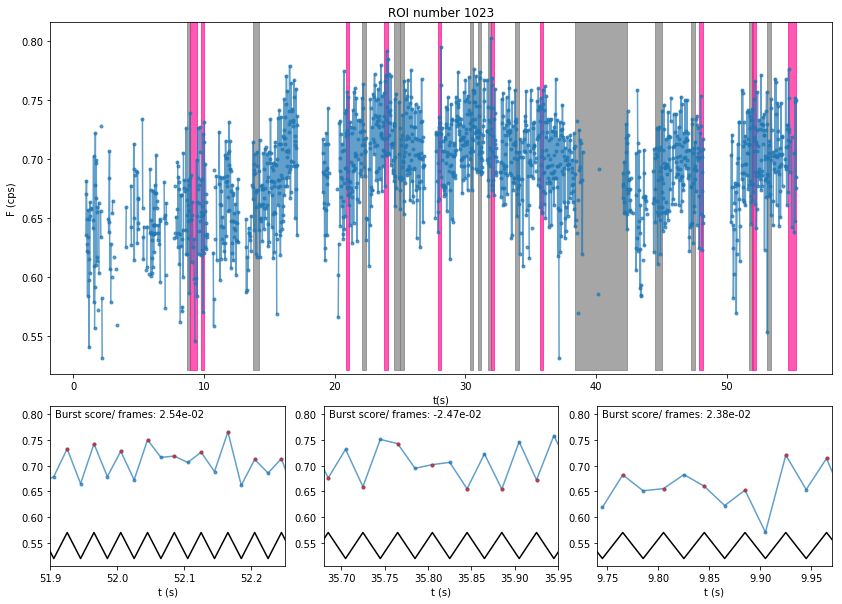

In [33]:
total = 0
for i in range(nrois):
    stats = fullstats[i][0]
    if type(stats) is dict:
        temp = stats['burstIdR score']
        #print(temp)
        try:
            if sum(abs(temp[:,0]/temp[:,-1])>0.022)>1:
                total +=1

                FB = 1.0*wave[i,:] # Blue channel
                FA = 1.0*wave[i+nrois,:] # red channel
                St = FA+FB

                St,SX,Stt,SXt,dR,dF,idxF,Fav = preparedata(FA,FB,4,nframes)
                stats = fullstats[i][0]
                #print((temp[:,0]/temp[:,-1]))
                plotFigureR(SXt,idxF,stats,ctitle ="ROI number "+str(i+1).zfill(4) )
        except Exception as e:
            print(i," roi:",e)
print(total)

/users/bssn/serna/environments/deepl/lib/python3.6/site-packages/ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in greater


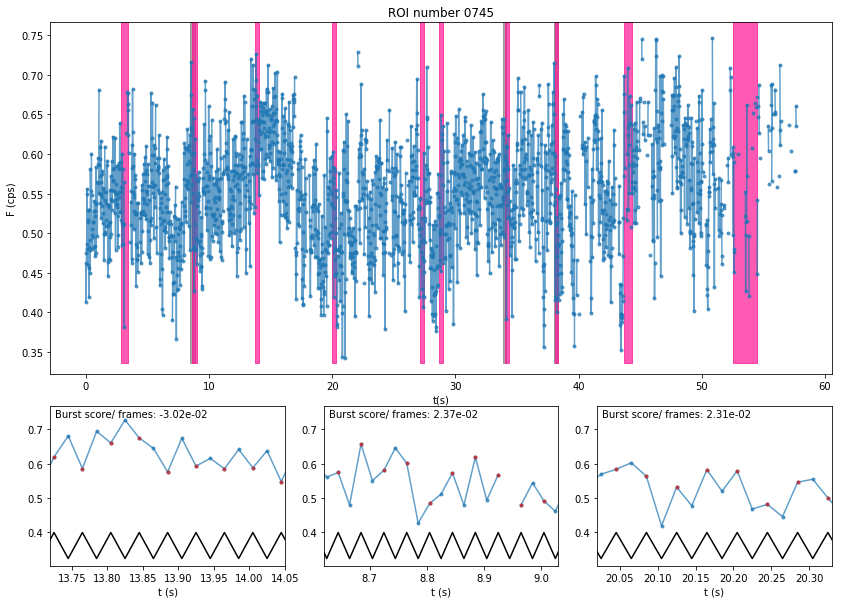

In [36]:
i = 744
stats = fullstats[i][0]
if type(stats) is dict:
    temp = stats['burstIdR score']
    #print(temp)
    try:
        if sum(abs(temp[:,0]/temp[:,-1])>0.022)>1:

            FB = 1.0*wave[i,:] # Blue channel
            FA = 1.0*wave[i+nrois,:] # red channel
            St = FA+FB

            St,SX,Stt,SXt,dR,dF,idxF,Fav = preparedata(FA,FB,4,nframes)
            stats = fullstats[i][0]
            #print((temp[:,0]/temp[:,-1]))
            plotFigureR(SXt,idxF,stats,ctitle ="ROI number "+str(i+1).zfill(4) )
    except Exception as e:
        print(i," roi:",e)


[-0.0126795   0.02370489 -0.03019901  0.02311887 -0.02092514 -0.02178567
  0.01729529 -0.02288322 -0.01217652 -0.00334808]
[579 596]
1372 1406
13.72 14.05
(1500, 2)
(6000,)
(1500, 2) (1500, 2)
(9, 2)
0.05814628544180023


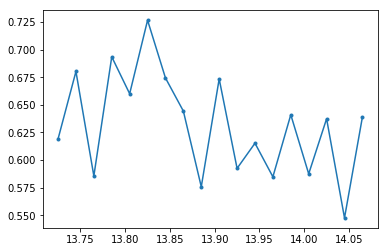

In [74]:
scores = stats['burstIdR score']
print(scores[:,0]/scores[:,-1])
burst = stats['burstIdR']
print(burst[2])
b = burst[2]
t = arange(0,6000)*10e-3
t0,tf = idxF[b[0]:b[1]][array([0,-1])]
tf += 2
print(t0,tf)
ts = t.reshape(1500,4)
t = t[t0:tf]
tt0 = t[0]
ttf = t[-1]
print(t[0],t[-1])
Stt2 = SXt*1.0
Stt2 = column_stack((Stt2[:,:framespercycle2].mean(axis=1),Stt2[:,framespercycle2:].mean(axis=1)))
ts = column_stack((ts[:,:framespercycle2].mean(axis=1),ts[:,framespercycle2:].mean(axis=1)))

print(Stt2.shape)
print(SXt.flatten().shape)
sel = (ts[:,0]>tt0)*(ts[:,0]<ttf)
#tsb = t[t0:tf].flatten() 
print(Stt2.shape,ts.shape)
plot(ts[sel,:].flatten(),Stt2[sel,:].flatten(),'.-')
Stt2s = Stt2[sel,:]
print(Stt2s.shape)
print(mean(Stt2s[:,1]-Stt2s[:,0]))

In [65]:
print(stats['burstIdF'],dF[isfinite(dF)].shape)

[[ 751  773]
 [1040 1054]
 [1269 1281]] (1287,)


In [150]:
t[idxF][:10]

array([0.  , 0.02, 0.04, 0.06, 0.08, 0.1 , 0.12, 0.14, 0.16, 0.18])